<a href="https://colab.research.google.com/github/stephanekouamo/RiceApp/blob/master/Predict_Rice_Group11.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

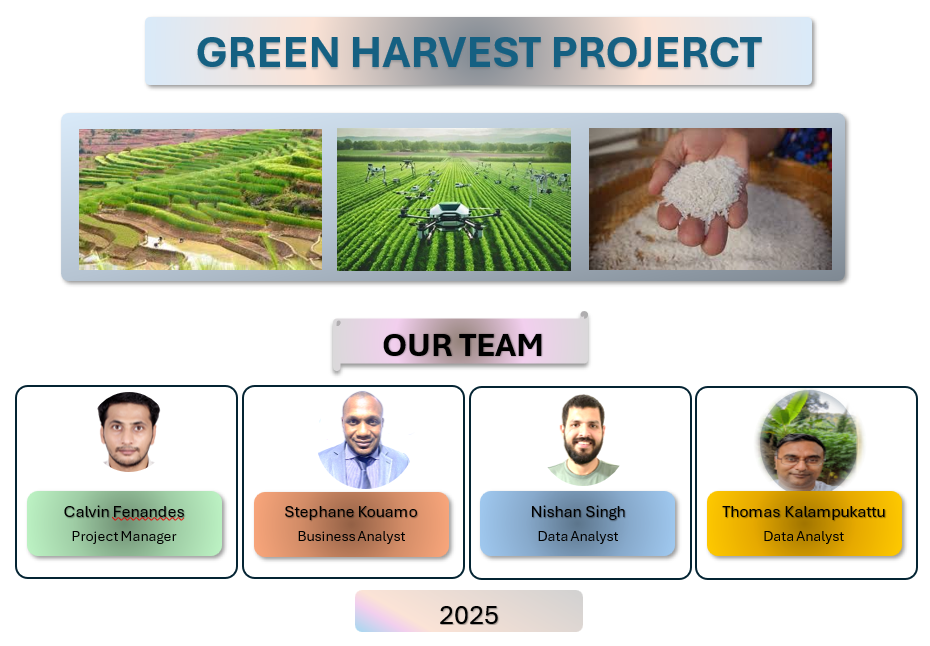

# **Objective**
Predict the rice yield for Madagascar using field data and compare it to the top five rice-producing countries in the world. To achieve this, we will follow a complete data modeling pipeline, including:

*   Data Preprocessing and Cleaning
*   Handling Missing Values and Outliers
*   Dimensionality Reduction
*   Modeling: Applying multiple machine learning models
*   Evaluation: Using multiple performance metrics to evaluate the models
*   Model Selection: Choosing the best-performing model.

# Step1. Import Required Libraries

In [4]:
pip install tensorflow

In [5]:
import seaborn as sns
import pandas as pd
import numpy as np
import shap
import time
import os
import matplotlib.pyplot as plt

from sklearn.metrics import make_scorer, mean_squared_error, mean_absolute_error, r2_score

from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import train_test_split

from sklearn.model_selection import KFold, cross_val_score
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import LinearSVR
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import RMSprop
import warnings
warnings.filterwarnings("ignore")

# **A. DATA PREPARATION**

# Step2. Load Dataset

In [7]:
df = pd.read_csv('/content/Data_Rice_2023_Group11.csv')
original_df=df

# Step3. Initial Exploration

In [8]:
print("Shape of dataset:", df.shape)
print("\n First 5 rows:")
print(df.head())

Shape of dataset: (200000, 36)

 First 5 rows:
   Region Region_Name     Period  Area (ha)  Culture  Cultivation practices  \
0       1   Bongolava  1/12/2019       4.02        1                    1.0   
1       2       Itasy  1/12/2020       2.68        1                    1.0   
2       3       Diana  1/12/2021       3.17        1                    1.0   
3       4       Boeny  1/12/2022       0.28        1                    1.0   
4       5    Vatovavy  1/12/2023       0.94        1                    1.0   

   Type of crop  Sowing method     Sowing method name Variety Name  ...  \
0           3.0            2.0  In-line transplanting         X265  ...   
1           3.0            3.0       Broadcast sowing         X265  ...   
2           NaN            2.0  In-line transplanting         X265  ...   
3           1.0            4.0      Direct row sowing         X265  ...   
4           1.0            3.0       Broadcast sowing         X265  ...   

   Harvester used Destinati

In [9]:
print("\n Informations on our dataset:")
print(df.info())
print("\n Describe our dataset:")
print(df.describe().T)
print("\n Describe our dataset using dtypes:")
print(df.dtypes)


 Informations on our dataset:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 36 columns):
 #   Column                                        Non-Null Count   Dtype  
---  ------                                        --------------   -----  
 0   Region                                        200000 non-null  int64  
 1   Region_Name                                   200000 non-null  object 
 2   Period                                        200000 non-null  object 
 3   Area (ha)                                     199534 non-null  float64
 4   Culture                                       200000 non-null  int64  
 5   Cultivation practices                         199844 non-null  float64
 6   Type of crop                                  197924 non-null  float64
 7   Sowing method                                 199602 non-null  float64
 8   Sowing method name                            199602 non-null  object 
 9   Variety Name     

# Step3.1 Standardization/Enconding or Labeling Variables


We have many variables that are ``Object``:


*   ``Region_Name``
*   ``Sowing method name``
*   ``Variety type name``
*   ``Cultivation_condition``
*   ``Type of irrigation name``
*   ``Agricultural Equipment Name``
*   ``Destination production name``
*   ``Technical support name``


We will Standardize some of them and remove others.


In [10]:
# We will create label for variable Variety Name automatically
from sklearn.preprocessing import LabelEncoder

# Initialize the label encoder
le = LabelEncoder()

# Fit and transform the 'Variety Name' column into label
df['Variety Name'] = le.fit_transform(df['Variety Name'].astype(str))+1
df.head()

,Region,Region_Name,Period,Area (ha),Culture,Cultivation practices,Type of crop,Sowing method,Sowing method name,Variety Name,...,Harvester used,Destination production,Destination production name,Technical support,Technical support name,Number of growing days,Dry weight (g/m2) /1000,Humidity level/10 (%),Weight of rice without moisture (g/m2) /1000,Yield (T/Ha)
0,1,Bongolava,1/12/2019,4.02,1,1.0,3.0,2.0,In-line transplanting,54,...,1,2,Self-consumption,2,Seed Donation,114,0.452652,0.12,0.452109,4.521088
1,2,Itasy,1/12/2020,2.68,1,1.0,3.0,3.0,Broadcast sowing,54,...,1,3,Both,5,Vulgarisation,146,0.301768,0.11,0.301436,3.014361
2,3,Diana,1/12/2021,3.17,1,1.0,NaN,2.0,In-line transplanting,54,...,1,2,Self-consumption,3,Training,121,0.356942,0.19,0.356264,3.562638
3,4,Boeny,1/12/2022,0.28,1,1.0,1.0,4.0,Direct row sowing,54,...,2,1,Sale,2,Seed Donation,64,0.005376,0.21,0.039583,0.395832
4,5,Vatovavy,1/12/2023,0.94,1,1.0,1.0,3.0,Broadcast sowing,54,...,2,2,Self-consumption,1,Financial Aid,73,0.018048,0.10,0.039583,0.395832


#Additional Data
Overview of Top 25 Rice producer in the world

In [11]:
pip install -U kaleido

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.0/69.0 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.3/49.3 kB 1.6 MB/s eta 0:00:00


Top 25 Countries Rice Yield, Production and Harvested Area

In [12]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

# --- Data (2023) ---
data = {
    "Country": [
        "China", "India", "Bangladesh", "Indonesia", "Vietnam", "Thailand", "Myanmar",
        "Philippines", "Pakistan", "Cambodia", "Brazil", "Japan", "United States",
        "Nigeria", "South Korea", "Nepal", "Egypt", "Madagascar", "Sri Lanka",
        "Laos", "Tanzania", "Guinea", "Peru", "Mali", "Colombia", "Malaysia", "Côte d’Ivoire"
    ],

    # Production (tons)
    "Production": [
        208064200, 206727000, 58613458, 53980993, 43497625, 33070957, 25650000,
        20059562, 14803800, 12900000, 10285663, 10136000, 9901510,
        8902200, 7274170, 5724200, 5486500, 5117636, 4513431,
        3835000, 3588000, 3534800, 3367614, 3023891, 3006100, 2166738, 2011500
    ],

    # Harvested Area (ha) - ***sample realistic values for 2023***
    "Harvested Area": [
        30000000, 44000000, 11500000, 14500000, 7050000, 11050000, 10100000,
        5000000, 3100000, 3300000, 2500000, 1500000, 1100000,
        6400000, 950000, 1400000, 700000, 1800000, 900000,
        850000, 1200000, 800000, 500000, 850000, 550000, 700000, 850000
    ],

    # Yield (tons/ha) = Production / Harvested Area
    "Yield": []
}

# --- Calculate Yield ---
for prod, area in zip(data["Production"], data["Harvested Area"]):
    data["Yield"].append(prod / area)

df_data = pd.DataFrame(data)

# ============================================================
# Helper function to create a choropleth map
# ============================================================
def create_map(df_data, column, title, color_scale):
    fig = px.choropleth(
        df_data,
        locations="Country",
        locationmode="country names",
        color=column,
        hover_name="Country",
        hover_data={column: ":,.2f"},
        color_continuous_scale=color_scale,
        title=title
    )

    # Add text annotations (label + value)
    text_data = [
        f"{country}<br>{value:,.2f}"
        for country, value in zip(df_data["Country"], df_data[column])
    ]

    fig.add_trace(go.Scattergeo(
        locations=df_data["Country"],
        locationmode="country names",
        text=text_data,
        mode="text",
        textfont=dict(size=11, color="black"),
        textposition="top center",
        showlegend=False
    ))

    fig.update_layout(
        geo=dict(showframe=False, showcoastlines=True, projection_type="natural earth"),
        title_x=0.5,
        margin=dict(l=0, r=0, t=40, b=0)
    )

    fig.show()

# ============================================================
# Generate the 3 maps
# ============================================================

# Production Map
create_map(
    df_data,
    "Production",
    "Global Rice Production by Country (2023)",
    "YlOrRd"
)

# Harvested Area Map
create_map(
    df_data,
    "Harvested Area",
    "Global Rice Harvested Area by Country (2023)",
    "Greens"
)

# Yield Map
create_map(
    df_data,
    "Yield",
    "Global Rice Yield (tons/ha) by Country (2023)",
    "Blues"
)


Top 10 Countries Rice Yield in the World

# Step3.2 Exploration Data Analysis

Univariate Analysis
 - Region
 - Type of Irrigation
 - Method of Sowing
   
Multivariate Analysis
 - Yearly Average (T/ha) Yield Across Regions (Region, Period, Yield)
 - Average Area (ha) over Region (Region, Area)
 - Trends in Average Organic Fertilizer (kg) Use by Region and Year (Region, Period, Organic Fertilizer)
 - Average Quantity of Seeds Used (kg) over Region (Region, Quantity of Seed Used)

#**Univariate Analysis**
***i) Distribution of Sowing method***

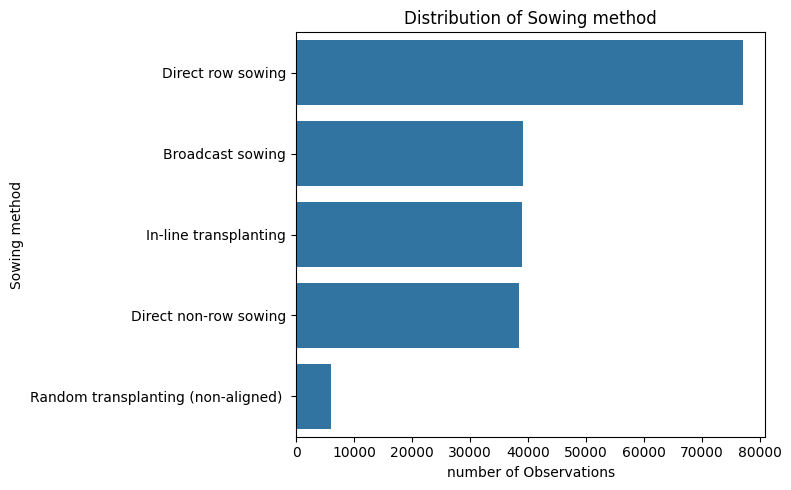

In [13]:
#Count frequencies
sowing_counts=df['Sowing method name'].value_counts()

#Bar plot
plt.figure(figsize=(8,5))
sns.countplot(data=df, y="Sowing method name", order=sowing_counts.index)
plt.title("Distribution of Sowing method")
plt.xlabel("number of Observations")
plt.ylabel("Sowing method")
plt.tight_layout()
plt.show()


***ii) Distribution of Variety cycle***

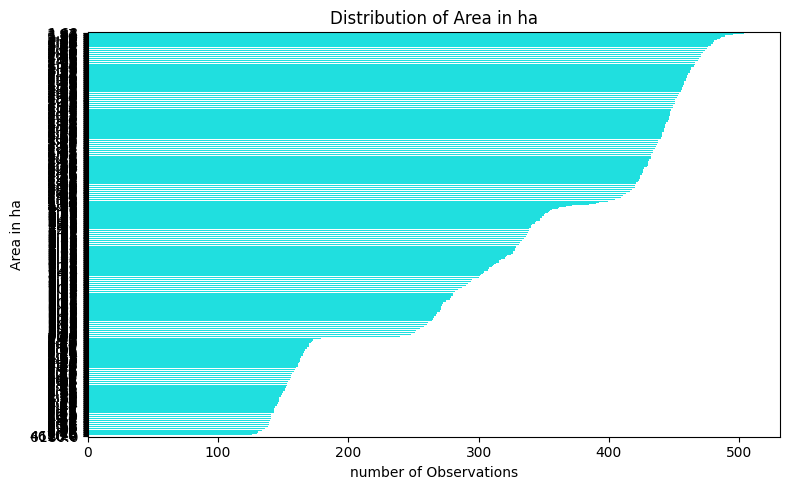

In [14]:
#Count frequencies
cycle_counts=df['Area (ha)'].value_counts()

#Bar plot
plt.figure(figsize=(8,5))
sns.countplot(data=df, y="Area (ha)", order=df['Area (ha)'].value_counts().index, color='cyan')
plt.title("Distribution of Area in ha")
plt.xlabel("number of Observations")
plt.ylabel("Area in ha")
plt.tight_layout()
plt.show()

***iii) Irrigation type distribution***

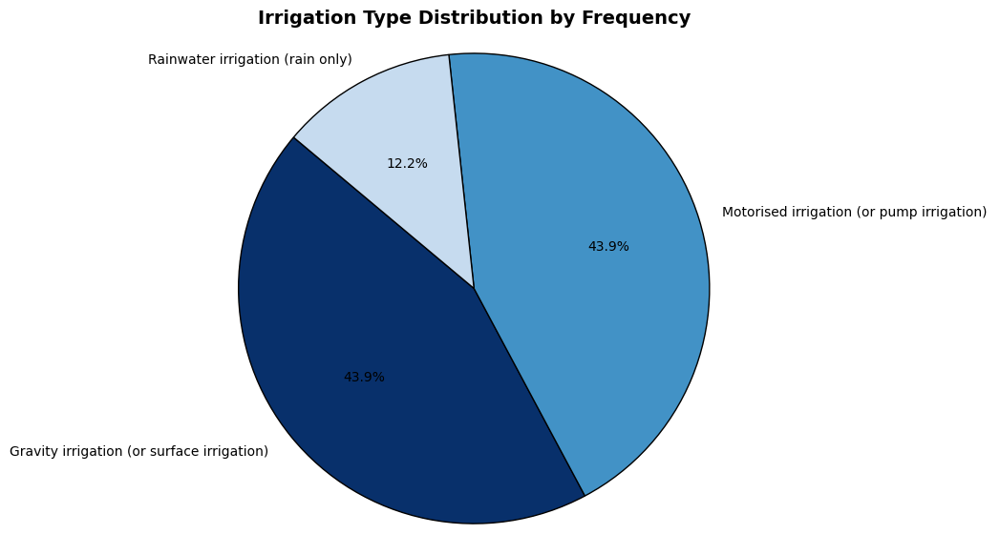

In [15]:
# Count frequencies
irrig_counts = df['Type of irrigation name'].value_counts()
# Sort the index by frequency
labels = irrig_counts.index
sizes = irrig_counts.values
# Assign blue shades (dark → light)
blues = ['#08306b', '#4292c6', '#c6dbef'][:len(sizes)]  # dark blue, light blue, sky blue

# Plot the pie chart
plt.figure(figsize=(7,7))
plt.pie(
    sizes,
    labels=labels,
    autopct='%1.1f%%',
    startangle=140,
    colors=blues,
    wedgeprops={'edgecolor': 'black'}
)
plt.title("Irrigation Type Distribution by Frequency", fontsize=14, weight='bold')
plt.axis('equal')  # Keep the pie chart circular
plt.show()

####### Plotting a Card for Type of Irrigation
# Count frequencies
#irrig_counts = df['Type of irrigation name'].value_counts()

# Most common irrigation type
#top_type = irrig_counts.index[0]
#top_percent = (irrig_counts.iloc[0] / irrig_counts.sum()) * 100

# --- Create a card-style figure ---
#plt.figure(figsize=(6,4))
#plt.text(
#    0.5, 0.6,
#    "Most Common Irrigation Type",
#    fontsize=16, weight='bold', ha='center'
#)

#plt.text(
#    0.5, 0.35,
#    f"{top_type}\n{top_percent:.1f}% of all fields",
#    fontsize=22, weight='bold', ha='center', color="#08306b"
#)

#plt.box(False)  # remove axes
#plt.xticks([])
#plt.yticks([])

#plt.tight_layout()
#plt.show()


Destination of Production Distribution


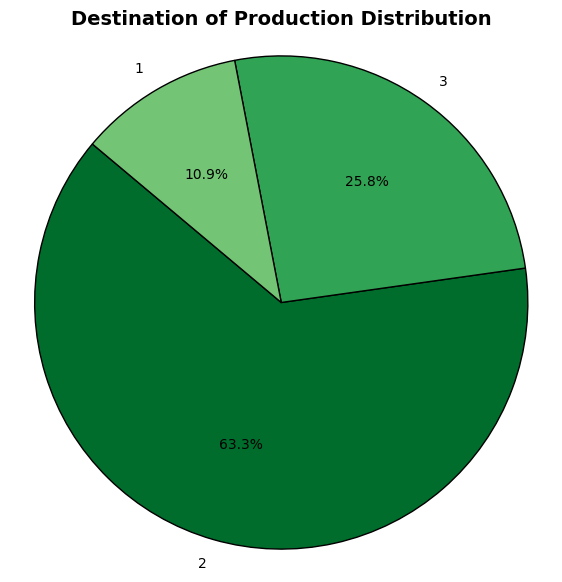

In [16]:
# Count frequencies
dest_counts = df['Destination production'].value_counts()

# Labels and values
labels = dest_counts.index
sizes = dest_counts.values

# Custom color palette (shades of green)
colors = ['#006d2c', '#31a354', '#74c476', '#bae4b3', '#edf8e9'][:len(sizes)]

# Plot the pie chart
plt.figure(figsize=(7,7))
plt.pie(
    sizes,
    labels=labels,
    autopct='%1.1f%%',
    startangle=140,
    colors=colors,
    wedgeprops={'edgecolor': 'black'}
)

plt.title("Destination of Production Distribution", fontsize=14, weight='bold')
plt.axis('equal')  # Keep it circular
plt.show()

Distribution of Technical Support

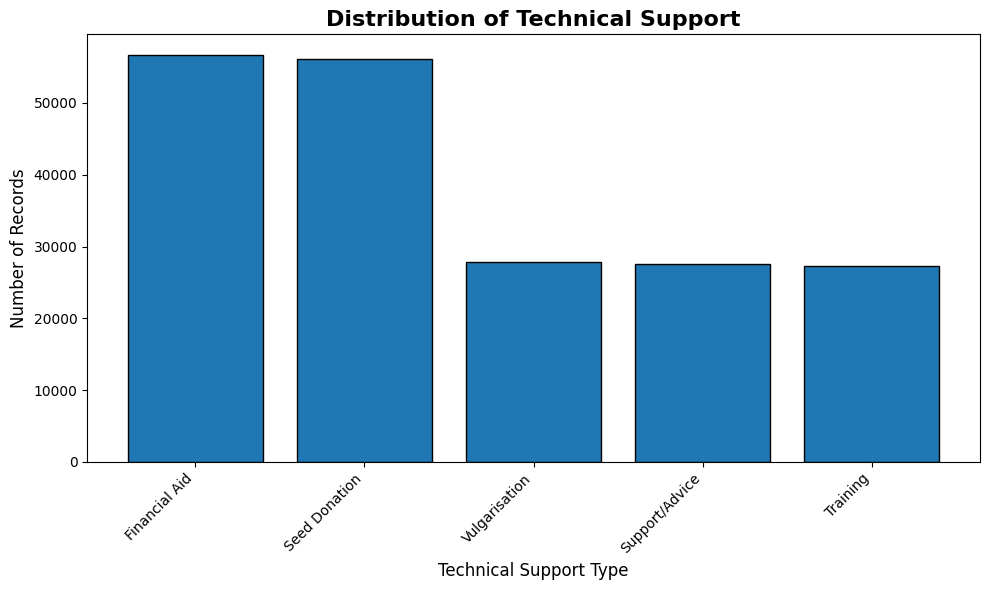

In [17]:
# Count frequencies
tech_counts = df['Technical support name'].value_counts()

# Labels and values
labels = tech_counts.index
values = tech_counts.values

# Plot bar chart
plt.figure(figsize=(10,6))
plt.bar(
    labels,
    values,
    color="#1f77b4",
    edgecolor="black"
)

# Add labels and formatting
plt.title("Distribution of Technical Support", fontsize=16, weight='bold')
plt.xlabel("Technical Support Type", fontsize=12)
plt.ylabel("Number of Records", fontsize=12)
plt.xticks(rotation=45, ha="right")
plt.tight_layout()

plt.show()

Quantity of chemical fertiliser (kg) (Gauge)

In [18]:
import plotly.graph_objects as go
# Compute the mean chemical fertilizer quantity
avg_fertilizer = df["Quantity of chemical fertiliser (kg)"].mean()

# Create Gauge Chart
fig = go.Figure(go.Indicator(
    mode = "gauge+number",
    value = avg_fertilizer,
    title = {'text': "Average Chemical Fertilizer Used (kg)"},
    gauge = {
        'axis': {'range': [0, df["Quantity of chemical fertiliser (kg)"].max()]},
        'bar': {'color': "#1f77b4"},
        'steps': [
            {'range': [0, avg_fertilizer*0.5], 'color': '#c6dbef'},
            {'range': [avg_fertilizer*0.5, avg_fertilizer], 'color': '#9ecae1'},
            {'range': [avg_fertilizer, df["Quantity of chemical fertiliser (kg)"].max()], 'color': '#6baed6'}
        ],
        'threshold': {
            'line': {'color': "red", 'width': 4},
            'thickness': 0.7,
            'value': avg_fertilizer
        }
    }
))

fig.update_layout(height=350)
fig.show()

***iv) Analysis of Variety type of seed used***

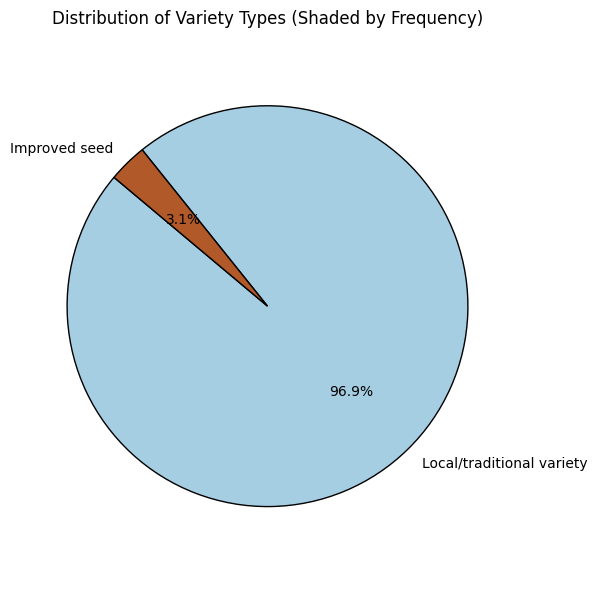

In [19]:
# Count frequencies
variety_counts = df['Variety type name'].value_counts()

# Extract labels and sizes
labels = variety_counts.index
sizes = variety_counts.values

# Choose a color map (many options: 'viridis', 'plasma', 'cool', 'winter', 'Paired', etc.)
colors = plt.cm.Paired(np.linspace(0, 1, len(labels)))

# Plot Pie chart
plt.figure(figsize=(6,6))
plt.pie(
    sizes,
    labels=labels,
    autopct='%1.1f%%',
    startangle=140,
    colors=colors,
    wedgeprops={'edgecolor': 'black'}
)
plt.title("Distribution of Variety Types (Shaded by Frequency)")
plt.axis('equal')  # Keep the pie chart circular
plt.tight_layout()
plt.show()

# **Multivariate analysis**



***i) Sunburst chart (by Region)***

In [20]:
import plotly.express as px

# Columns required
cols_needed = [
    'Type of irrigation name',
    'Region_Name',
    'Sowing method name',
    'Area (ha)'
]
df_clean = df.dropna(subset=cols_needed)
# Custom color palette
my_colors = ["#d3d3d3", "#87ceeb", "#90ee90", "#808080", "#0000ff"]

fig = px.sunburst(
    df_clean,
    path=[
        'Type of irrigation name',
        'Region_Name',
        'Sowing method name',
        'Area (ha)'
    ],
    values='Area (ha)',
    color='Region_Name',
    color_discrete_sequence=my_colors,
    maxdepth=-1
)
fig.update_layout(
    title="Multivariate Sunburst: Irrigation → Region → Sowing method → Area",
    title_x=0.5
)
fig.show()

***i) Scatterplot: Quantity of Seeds vs Yield (by Region)***

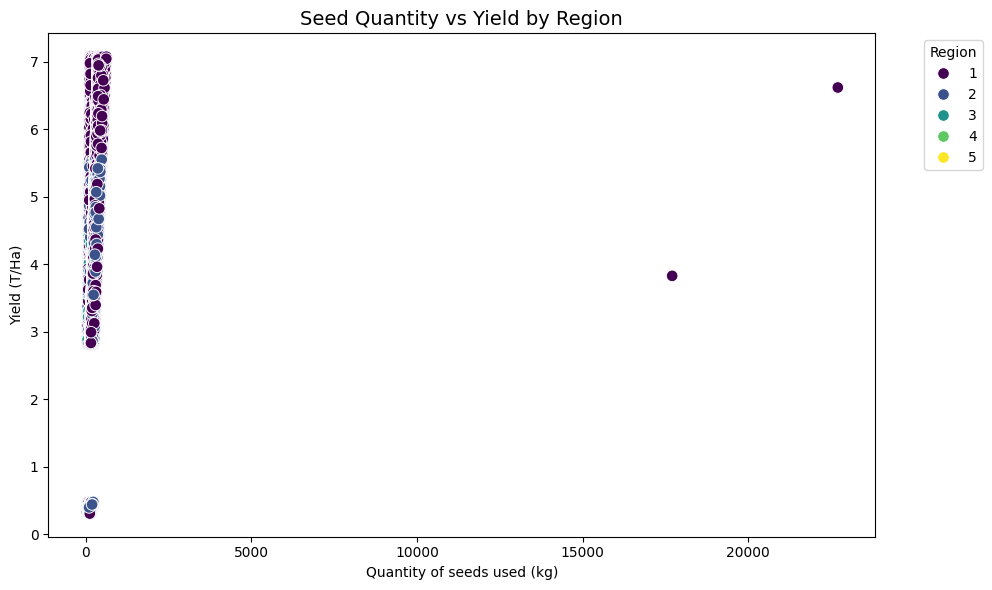

In [21]:
plt.figure(figsize=(10,6))

sns.scatterplot(
    data=df,
    x="Quantity of seeds used (kg)",
    y="Yield (T/Ha)",
    hue="Region",
    palette="viridis",  # optional, for better colors
    s=70                # optional, marker size
)

plt.title("Seed Quantity vs Yield by Region", fontsize=14)
plt.xlabel("Quantity of seeds used (kg)")
plt.ylabel("Yield (T/Ha)")
plt.legend(title='Region', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

***ii) Average Yield over Region***

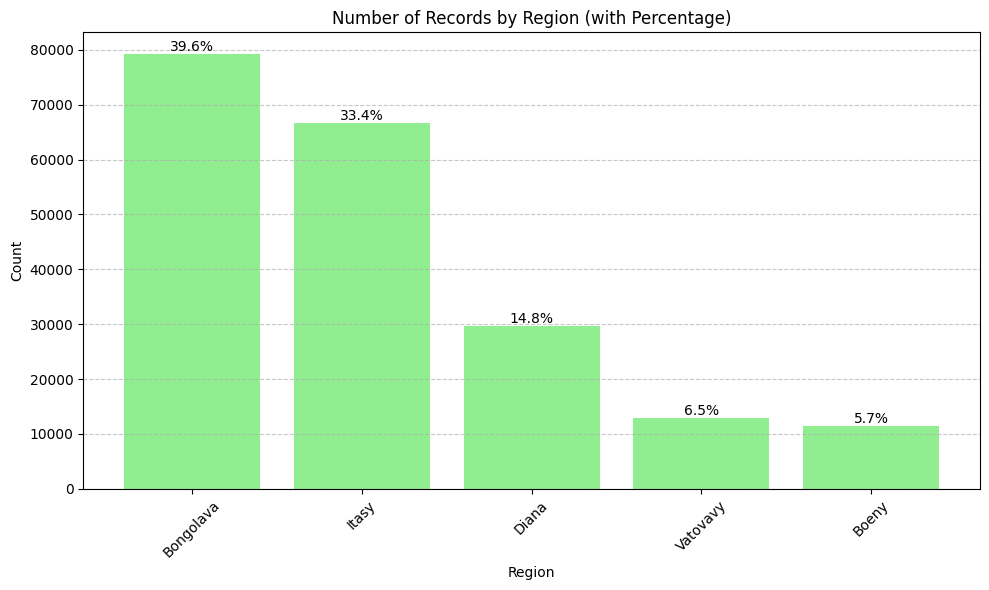

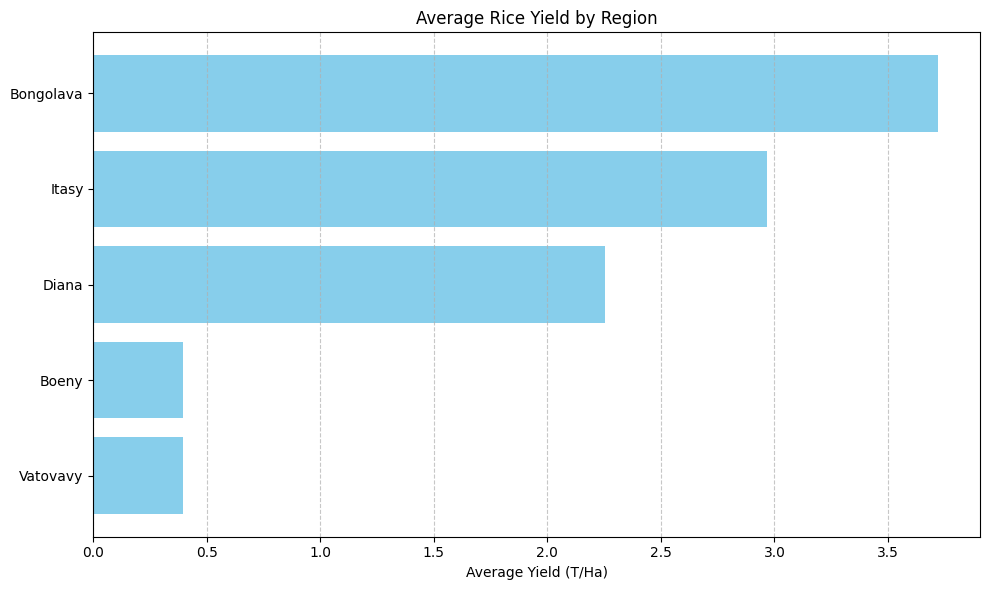

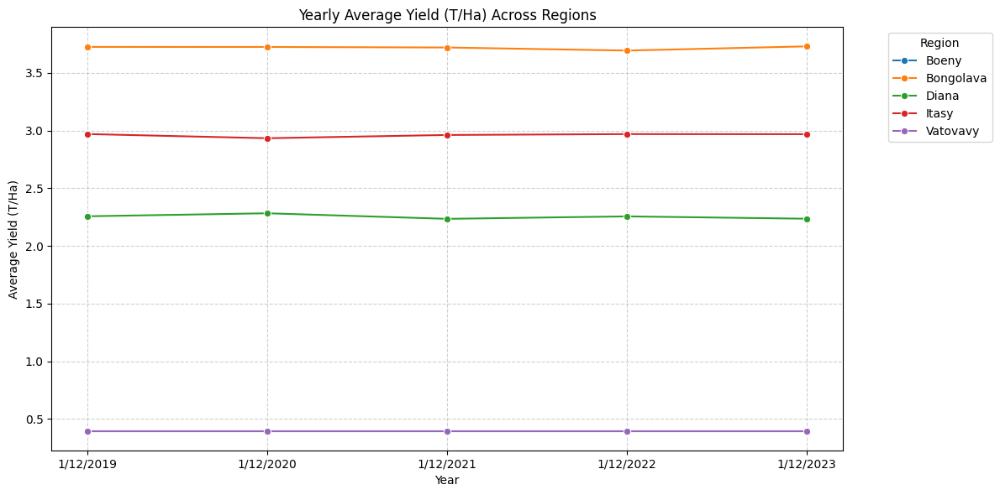

In [22]:
# Group by Region_Name and calculate average yield
region_yield = df.groupby('Region_Name')["Yield (T/Ha)"].mean().reset_index()

# Sort for better visualization
region_yield = region_yield.sort_values(by="Yield (T/Ha)", ascending=False)
#--------------------------- Analysis of Region -------------------------------------
# Count the number of records per region
region_counts = df['Region_Name'].value_counts().reset_index()
region_counts.columns = ['Region_Name', 'Count']
# Calculate percentage
total = region_counts['Count'].sum()
region_counts['Percentage'] = (region_counts['Count'] / total) * 100

plt.figure(figsize=(10, 6))
bars = plt.bar(region_counts['Region_Name'], region_counts['Count'], color='lightgreen')

# Add percentage labels on top of bars
for bar, pct in zip(bars, region_counts['Percentage']):
    plt.text(bar.get_x() + bar.get_width()/2, bar.get_height(), f'{pct:.1f}%',
             ha='center', va='bottom', fontsize=10)

plt.title("Number of Records by Region (with Percentage)")
plt.xlabel("Region")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()
#--------------------------------------------------------------------------------------------------
# -------------------Average Yield over Region ---------------------------------------------
plt.figure(figsize=(10, 6))
plt.barh(region_yield["Region_Name"], region_yield["Yield (T/Ha)"], color='skyblue')
plt.xlabel("Average Yield (T/Ha)")
plt.title("Average Rice Yield by Region")
plt.gca().invert_yaxis()  # Highest yield at the top
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()
#--------------------------------------------------------------------------------------------

#-----------------------------Yearly Average Yield (t/ha) Across Regions-------------------------
# Group by Region and Year (Period) and calculate average yield
yearly_yield = df.groupby(['Period', 'Region_Name'])['Yield (T/Ha)'].mean().reset_index()

plt.figure(figsize=(12, 6))
sns.lineplot(data=yearly_yield, x='Period', y='Yield (T/Ha)', hue='Region_Name', marker="o")

plt.title("Yearly Average Yield (T/Ha) Across Regions")
plt.xlabel("Year")
plt.ylabel("Average Yield (T/Ha)")
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(title='Region', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()
#--------------------------------------------------------------------------------------------------

***iii) Yield over Year***

<Axes: xlabel='Period'>

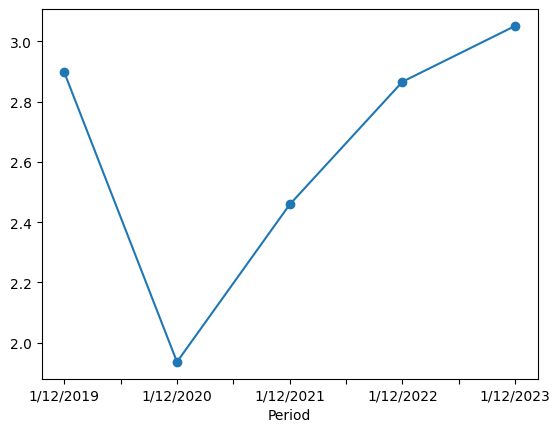

In [24]:
df.groupby("Period")["Yield (T/Ha)"].mean().plot(marker='o')

***iv) Average rice Yield over Region***

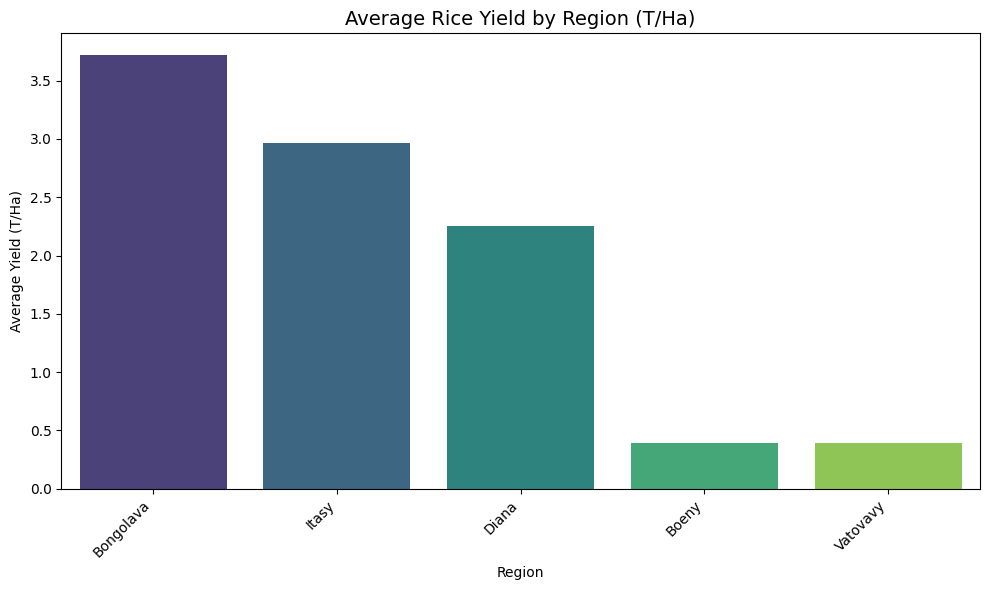

In [25]:
# --- Optional: Clean column names just in case ---
df.columns = df.columns.str.strip()  # remove extra spaces

# --- Compute average yield per region ---
avg_yield = df.groupby("Region_Name")["Yield (T/Ha)"].mean().reset_index()

# --- Sort values for better visualization ---
avg_yield = avg_yield.sort_values(by="Yield (T/Ha)", ascending=False)

# --- Plot ---
plt.figure(figsize=(10, 6))
sns.barplot(
    data=avg_yield,
    x="Region_Name",
    y="Yield (T/Ha)",
    palette="viridis"
)

# --- Labels and title ---
plt.title("Average Rice Yield by Region (T/Ha)", fontsize=14)
plt.xlabel("Region")
plt.ylabel("Average Yield (T/Ha)")
plt.xticks(rotation=45, ha='right')  # rotate x labels for readability
plt.tight_layout()
plt.show()

***v) 3D Scatter Plot: Region vs Yield, Color by Area, Size by Area***

In [26]:
import plotly.express as px

# Drop rows with missing values in relevant columns
df_clean = df.dropna(subset=['Region_Name', 'Yield (T/Ha)', 'Area (ha)'])

# 3D scatter plot
fig = px.scatter_3d(
    df_clean,
    x='Region_Name',              # X-axis
    y='Yield (T/Ha)',             # Y-axis
    z='Area (ha)',                # Z-axis
    color='Area (ha)',            # color by area
    size='Area (ha)',             # size by area
    color_continuous_scale='Viridis',
    size_max=20,
    hover_data={
        'Region_Name': True,
        'Yield (T/Ha)': True,
        'Area (ha)': True
    },
    height=600,
    width=1000
)

fig.update_layout(
    title="3D Scatter: Yield by Region Colored and Sized by Cultivated Area",
    scene=dict(
        xaxis_title='Region',
        yaxis_title='Yield (T/Ha)',
        zaxis_title='Area (ha)'
    )
)

fig.show()



3D Scatter: Yield by Region and Quantity of organic fertiliser Colored and Sized by Yield

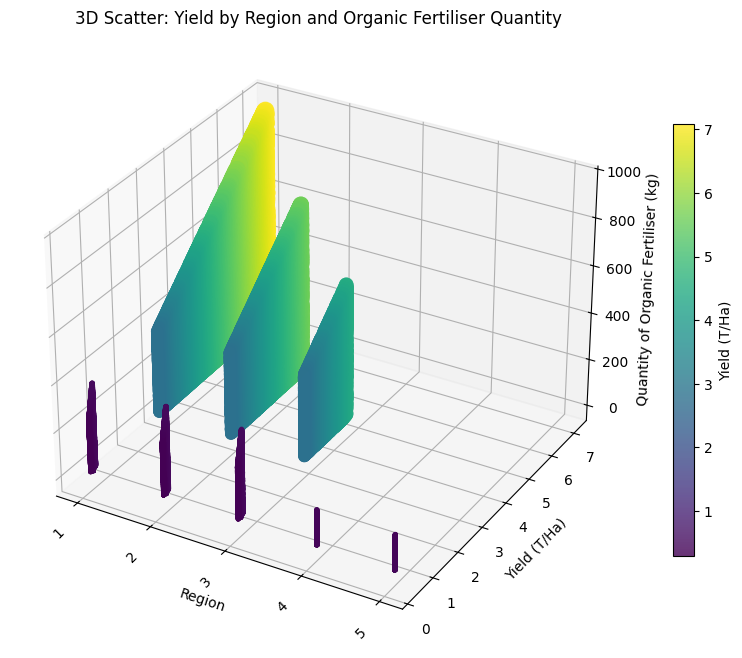

In [27]:
from mpl_toolkits.mplot3d import Axes3D
# Clean data using the correct column names
df_clean = df.dropna(subset=['Region_Name', 'Yield (T/Ha)', 'Quantity of organic fertiliser (kg)'])
# Convert region names to numeric codes for X-axis
df_clean['Region_Code'] = df_clean['Region'].astype('category').cat.codes
# Seaborn color palette as colormap
palette = sns.color_palette("viridis", as_cmap=True)

fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(
    df_clean['Region_Code'],
    df_clean['Yield (T/Ha)'],
    df_clean['Quantity of organic fertiliser (kg)'],
    c=df_clean['Yield (T/Ha)'],
    cmap='viridis',
    s=df_clean['Yield (T/Ha)'] * 20,
    alpha=0.8
)
# Replace X-axis ticks with real region names
ax.set_xticks(df_clean['Region_Code'].unique())
ax.set_xticklabels(df_clean['Region'].unique(), rotation=45, ha='right')
# Axis labels
ax.set_xlabel("Region")
ax.set_ylabel("Yield (T/Ha)")
ax.set_zlabel("Quantity of Organic Fertiliser (kg)")
ax.set_title("3D Scatter: Yield by Region and Organic Fertiliser Quantity")
# Add colorbar
cbar = plt.colorbar(scatter, ax=ax, shrink=0.7)
cbar.set_label("Yield (T/Ha)")
plt.tight_layout()
plt.show()


***vi) 3D Scatter: Organic Fertilizer vs Region vs Yield***

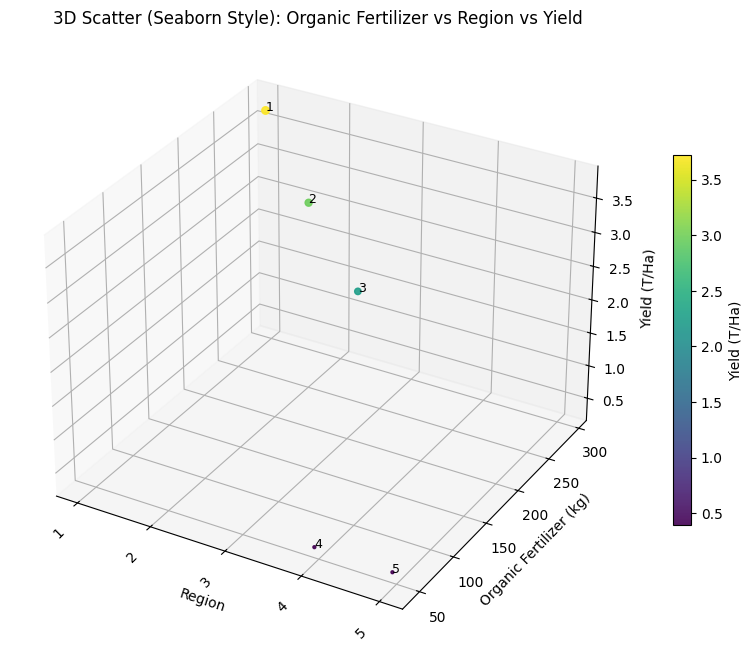

In [28]:
# Aggregate data by region (using correct column name "Region")
region_fertilizer = df.groupby("Region", as_index=False).agg({
    "Quantity of organic fertiliser (kg)": "mean",
    "Yield (T/Ha)": "mean"
})
# Convert region names to numeric codes for Matplotlib
region_fertilizer["Region_Code"] = region_fertilizer["Region"].astype("category").cat.codes
# Use a Seaborn colormap similar to Plotly's Viridis
cmap = sns.color_palette("viridis", as_cmap=True)
# Create 3D figure
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
# 3D scatter
scatter = ax.scatter(
    region_fertilizer["Region_Code"],
    region_fertilizer["Quantity of organic fertiliser (kg)"],
    region_fertilizer["Yield (T/Ha)"],
    c=region_fertilizer["Yield (T/Ha)"],
    cmap=cmap,
    s=region_fertilizer["Quantity of organic fertiliser (kg)"] * 0.1,  # scale sizes
    alpha=0.9
)
# Replace X-ticks with region names
ax.set_xticks(region_fertilizer["Region_Code"])
ax.set_xticklabels(region_fertilizer["Region"], rotation=45, ha='right')
# Label each point with the region name
for i in range(len(region_fertilizer)):
    ax.text(
        region_fertilizer["Region_Code"].iloc[i],
        region_fertilizer["Quantity of organic fertiliser (kg)"].iloc[i],
        region_fertilizer["Yield (T/Ha)"].iloc[i],
        region_fertilizer["Region"].iloc[i],
        fontsize=9
    )
# Axis labels
ax.set_xlabel("Region")
ax.set_ylabel("Organic Fertilizer (kg)")
ax.set_zlabel("Yield (T/Ha)")
ax.set_title("3D Scatter (Seaborn Style): Organic Fertilizer vs Region vs Yield")
# Add colorbar
cbar = plt.colorbar(scatter, ax=ax, shrink=0.6)
cbar.set_label("Yield (T/Ha)")
plt.tight_layout()
plt.show()


***vii) Scatter Plot (3D) : Seed Quantity vs Region Colored by Yield***

In [29]:
import plotly.express as px

# Remove rows where seeds or yield is NaN
df_clean = df.dropna(subset=['Quantity of seeds used (kg)', 'Yield (T/Ha)'])

# Optional: fill NaN size with a small number if you want to keep them
# df['Quantity of seeds used (kg)'] = df['Quantity of seeds used (kg)'].fillna(0.1)

# 3D Scatter Plot
fig = px.scatter_3d(
    df_clean,
    x='Region_Name',                 # x-axis
    y='Quantity of seeds used (kg)', # y-axis
    z='Yield (T/Ha)',                # z-axis
    color='Yield (T/Ha)',            # color by yield
    size='Quantity of seeds used (kg)', # size by seed quantity
    hover_data={
        'Region_Name': True,
        'Quantity of seeds used (kg)': True,
        'Yield (T/Ha)': True
    },
    color_continuous_scale='Viridis',
    height=600,
    width=1000
)

fig.update_layout(
    title="3D Scatter: Seed Quantity vs Region vs Yield",
    scene=dict(
        xaxis_title='Region',
        yaxis_title='Seed Quantity (kg)',
        zaxis_title='Yield (T/Ha)'
    )
)

fig.show()



viii) Does mean Area differ significantly accross irrigation type

ANOVA Results:
------------------------
F-statistic : 212.6618
P-value     : 0.000000

Conclusion: Significant difference in Area between irrigation types.


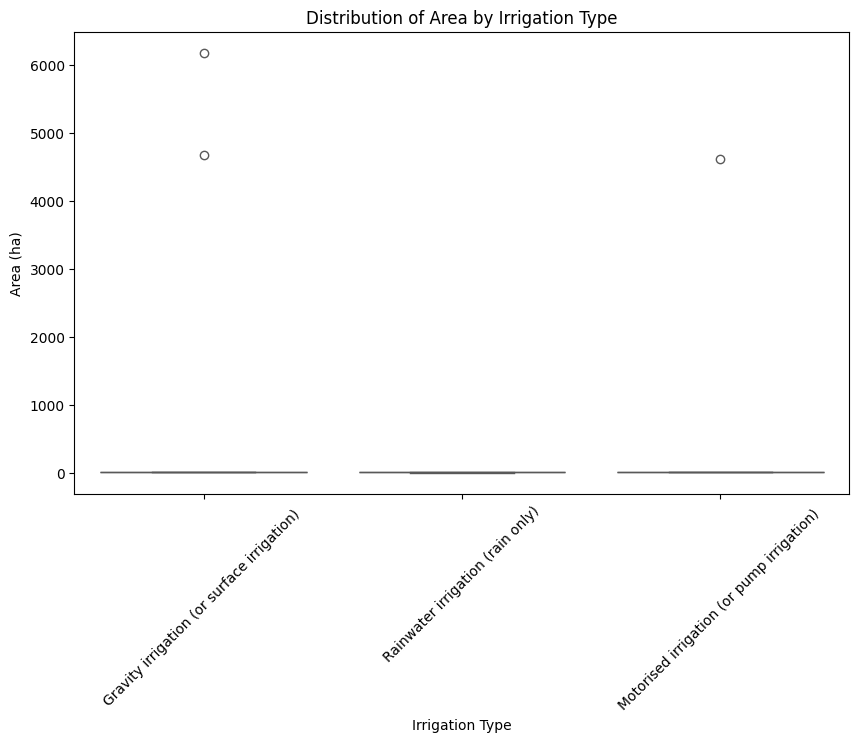

In [31]:
import scipy.stats as stats
# Drop rows with missing values in the fields used
df_anova = df.dropna(subset=['Area (ha)', 'Type of irrigation name'])
# Groups for ANOVA
groups = [
    group["Area (ha)"].values
    for name, group in df_anova.groupby("Type of irrigation name")
]
# Run ANOVA
f_stat, p_value = stats.f_oneway(*groups)
print("ANOVA Results:")
print("------------------------")
print(f"F-statistic : {f_stat:.4f}")
print(f"P-value     : {p_value:.6f}")
# Interpretation
alpha = 0.05
if p_value < alpha:
    print("\nConclusion: Significant difference in Area between irrigation types.")
else:
    print("\nConclusion: No significant difference in Area between irrigation types.")

#Boxplot to see results
plt.figure(figsize=(10,6))
sns.boxplot(data=df, x='Type of irrigation name', y='Area (ha)', palette='Set2')
plt.title("Distribution of Area by Irrigation Type")
plt.xlabel("Irrigation Type")
plt.ylabel("Area (ha)")
plt.xticks(rotation=45)
plt.show()


iX) MANOVA for Area (ha) vs  'Quantity of chemical fertiliser (kg)', 'Quantity of organic fertiliser (kg)', 'Quantity of plant protection', 'Quantity of seeds used (kg)',   'Harvested used'.

In [32]:
from statsmodels.multivariate.manova import MANOVA

#Creating Area Groups (Small, Midium, Large)

df_clean = df.dropna(subset=[
    'Area (ha)',
    'Quantity of chemical fertiliser (kg)',
    'Quantity of organic fertiliser (kg)',
    'Quantity of plant protection product (L)',
    'Quantity of seeds used (kg)',
    'Harvester used'
])

df_clean['Area_group'] = pd.qcut(
    df_clean['Area (ha)'],
    q=3,
    labels=['Small', 'Medium', 'Large']
)

#Encode categorical dependent variable (if include)
categorical_vars = [
    'Variety type',
    'Technical support name',
    'Sowing method name'
]

for col in categorical_vars:
    if col in df_clean.columns:
        df_clean[col] = df_clean[col].astype('category').cat.codes

# Run MANOVA

manova = MANOVA.from_formula(
    'Q("Quantity of chemical fertiliser (kg)") + \
     Q("Quantity of organic fertiliser (kg)") + \
     Q("Quantity of plant protection product (L)") + \
     Q("Quantity of seeds used (kg)") + \
     Q("Harvester used") + \
     Q("Variety type") + \
     Q("Technical support") + \
     Q("Sowing method") ~ Area_group',
    data=df_clean
)

print(manova.mv_test())



                      Multivariate linear model
                                                                     
---------------------------------------------------------------------
       Intercept         Value  Num DF    Den DF     F Value   Pr > F
---------------------------------------------------------------------
          Wilks' lambda  0.0371 8.0000 197730.0000 640847.6109 0.0000
         Pillai's trace  0.9629 8.0000 197730.0000 640847.6109 0.0000
 Hotelling-Lawley trace 25.9282 8.0000 197730.0000 640847.6109 0.0000
    Roy's greatest root 25.9282 8.0000 197730.0000 640847.6109 0.0000
---------------------------------------------------------------------
                                                                     
---------------------------------------------------------------------
        Area_group       Value   Num DF    Den DF    F Value   Pr > F
---------------------------------------------------------------------
           Wilks' lambda 0.2802 16.0000 39

3D Scatter: Fertilizers & Seeds by Area Group

In [48]:
# Drop rows with missing values for selected variables
df_plot = df_clean.dropna(subset=[
    'Quantity of chemical fertiliser (kg)',
    'Quantity of organic fertiliser (kg)',
    'Quantity of seeds used (kg)',
    'Area_group'
])

# 3D scatter plot
fig = px.scatter_3d(
    df_plot,
    x='Quantity of chemical fertiliser (kg)',
    y='Quantity of organic fertiliser (kg)',
    z='Quantity of seeds used (kg)',
    color='Area_group',              # highlight Area group
    symbol='Area_group',             # different markers per group
    size='Quantity of seeds used (kg)',  # optional: bubble size
    hover_data=['Harvester used', 'Variety type', 'Technical support'],
    color_discrete_sequence=['#FFD700', '#FFA500', '#FF4500'],  # yellow → orange → red
    height=600,
    width=1000
)

fig.update_layout(
    title="3D Scatter: Fertilizers & Seeds by Area Group",
    scene=dict(
        xaxis_title='Quantity of Chemical Fertiliser (kg)',
        yaxis_title='Quantity of Organic Fertiliser (kg)',
        zaxis_title='Quantity of Seeds Used (kg)'
    )
)

fig.show()


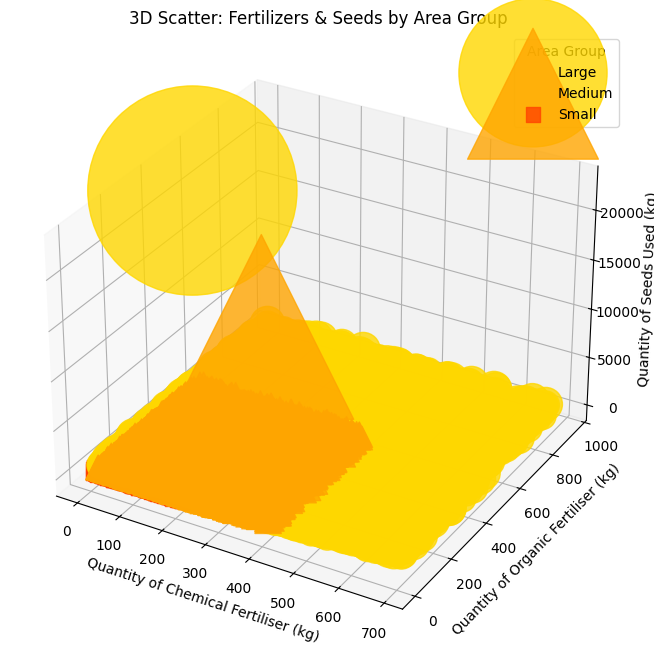

In [49]:
# Clean data (your subset)
df_plot = df_clean.dropna(subset=[
    'Quantity of chemical fertiliser (kg)',
    'Quantity of organic fertiliser (kg)',
    'Quantity of seeds used (kg)',
    'Area_group'
])

# Map Area_group to numeric codes for x/y/z markers
area_groups = df_plot['Area_group'].unique()
area_map = {area: i for i, area in enumerate(area_groups)}
df_plot['Area_Code'] = df_plot['Area_group'].map(area_map)

# Define markers for different Area_group
markers = ['o', '^', 's', 'D', 'P']  # circle, triangle, square, diamond, plus
marker_map = {area: markers[i % len(markers)] for i, area in enumerate(area_groups)}

# Seaborn color palette
palette = sns.color_palette(['#FFD700', '#FFA500', '#FF4500'], n_colors=len(area_groups))
color_map = {area: palette[i] for i, area in enumerate(area_groups)}

# Create 3D figure
fig = plt.figure(figsize=(12,8))
ax = fig.add_subplot(111, projection='3d')

# Plot each Area_group separately to control marker and color
for area in area_groups:
    subset = df_plot[df_plot['Area_group'] == area]
    ax.scatter(
        subset['Quantity of chemical fertiliser (kg)'],
        subset['Quantity of organic fertiliser (kg)'],
        subset['Quantity of seeds used (kg)'],
        c=[color_map[area]] * len(subset),
        marker=marker_map[area],
        s=subset['Quantity of seeds used (kg)'],  # size by seeds used
        label=area,
        alpha=0.8
    )

# Axis labels
ax.set_xlabel("Quantity of Chemical Fertiliser (kg)")
ax.set_ylabel("Quantity of Organic Fertiliser (kg)")
ax.set_zlabel("Quantity of Seeds Used (kg)")
ax.set_title("3D Scatter: Fertilizers & Seeds by Area Group")

# Legend
ax.legend(title='Area Group')

plt.show()


# **II. DATA CLEANING**

# II.1 Dimension reduction

We will remove columns that are not contributing significantly to the model, such as:

*   ``Region_Name``
*   ``Sowing method name``
*   ``Variety type name``
*   ``Cultivation_condition``
*   ``Type of irrigation name``
*   ``Agricultural Equipment Name``
*   ``Destination production name``
*   ``Technical support name``




In [35]:
# Define columns to drop
columns_to_drop = [
    'Region_Name',
    'Sowing method name',
    'Variety type name',
    'Cultivation_condition',
    'Type of irrigation name',
    'Agricultural Equipment Name',
    'Destination production name',
    'Technical support name'
]

# Drop the columns
df.drop(columns=columns_to_drop, inplace=True)

# II.2 Checking Missing values

We will apply the ``isnull()`` function to identify missing values and visualize them using the ``missingno`` library.

In [36]:
!pip install missingno


Missing values per column:
Region                                             0
Period                                             0
Area (ha)                                        466
Culture                                            0
Cultivation practices                            156
Type of crop                                    2076
Sowing method                                    398
Variety Name                                       0
Variety type                                     136
Variety cycle                                    594
Cultivation conditions                             0
Cause of poor conditions                          49
Quantity of seeds used (kg)                       66
Classified seed quantity (kg)                     66
Type of spacing                                   25
Type of irrigation                                 0
Quantity of organic fertiliser (kg)              228
Quantity of chemical fertiliser (kg)             634
Quantity of plant 

<Axes: >

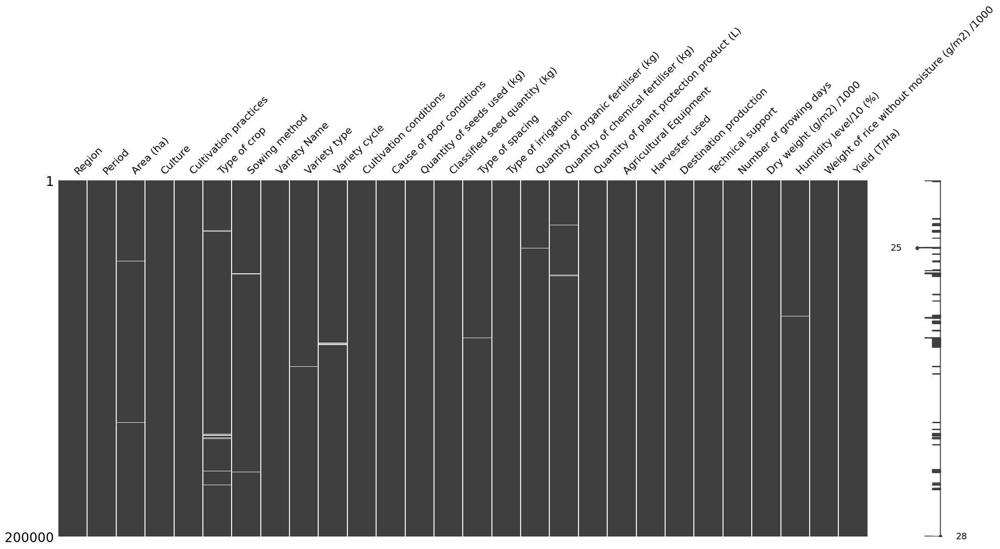

In [37]:
print("\nMissing values per column:")
print(df.isnull().sum())

# Visualizing missing data by using missingno library
import missingno as msno
msno.matrix(df)

# II.3 Handling Missing Values

**II.3.1. Strategy**

We will first use a correlation matrix to identify the relationships between variables and fill in the missing values accordingly.

If no significant correlation is found:

*   Numerical columns will be filled with the ``mean``.
*   Categorical columns will be filled with the ``mode``.






                                                Region  Area (ha)   Culture  \
Region                                        1.000000  -0.047286 -0.171111   
Area (ha)                                    -0.047286   1.000000  0.006315   
Culture                                      -0.171111   0.006315  1.000000   
Cultivation practices                        -0.262971   0.009903  0.651024   
Type of crop                                 -0.494027   0.028126  0.182802   
Sowing method                                -0.272928   0.011314  0.272272   
Variety Name                                 -0.243033   0.014791  0.198306   
Variety type                                 -0.066184   0.004003  0.054474   
Variety cycle                                -0.112462   0.006489  0.086473   
Cultivation conditions                       -0.459101   0.024152  0.098212   
Cause of poor conditions                      0.310346  -0.018210 -0.041030   
Quantity of seeds used (kg)                  -0.4698

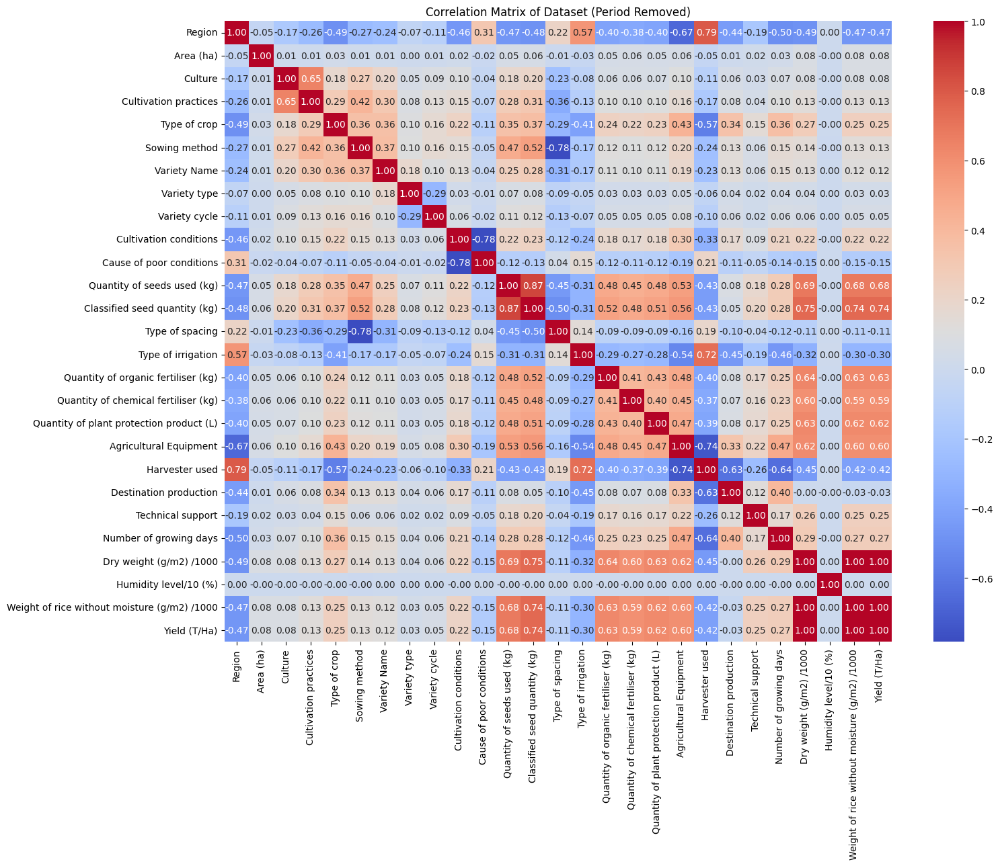

In [38]:
# --- Drop 'Period' if it exists ---
df_corr = df.drop(columns=['Period'], errors='ignore')

# --- Compute correlation only on numeric columns ---
corr_matrix = df_corr.select_dtypes(include='number').corr()

# --- Display correlation matrix ---
print(corr_matrix)

# --- Plot correlation heatmap ---
plt.figure(figsize=(16, 12))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Matrix of Dataset (Period Removed)")
plt.show()


Now we will split our dataset into categorical and numerical variables, storing them in two separate matrices named ``categorical_columns`` and ``numerical_columns`` to simplify the handling of missing values.

We will also check whether our dataset contains any duplicate records.

**II.3.2 Creation of two list of categorical and numerical variables and filling the blank**

In [39]:

# Creation of a list of categorical variables
categorical_columns = [
  'Region', 'Period', 'Cultivation practices', 'Type of crop', 'Sowing method',
  'Variety type', 'Variety cycle', 'Cultivation conditions', 'Cause of poor conditions',
  'Type of spacing', 'Type of irrigation', 'Agricultural Equipment',
  'Harvester used', 'Destination production', 'Technical support'
]

# Identify all other numeric columns (not in categorical list)
numerical_columns = [col for col in df.columns if col not in categorical_columns]

# Fill categorical columns with their mode
for col in categorical_columns:
  df[col] = df[col].fillna(df[col].mode()[0])
# Fill numeric columns with their mean
for col in numerical_columns:
  df[col] = df[col].fillna(df[col].mean())

**II.3.3 Sorting our dataset and Dropping duplicated values**

In [ ]:
# Sort our dataset matrix with correlation
top_corrs = corr_matrix.abs().unstack().sort_values(ascending=False)

# Drop self-correlations
top_corrs = top_corrs[top_corrs < 1]

# Drop duplicate pairs (A-B and B-A)
top_corrs = top_corrs[~top_corrs.duplicated()]

# II.4 Detecting Outliers by Using IQR Method

In [40]:
# We define an empty list
outliers = {}

# IQR method for each numerical column
for col in numerical_columns:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1

    # Define outlier boundaries
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Find outliers
    outlier_rows = df[(df[col] < lower_bound) | (df[col] > upper_bound)]

    if not outlier_rows.empty:
        outliers[col] = {
            'count': outlier_rows.shape[0],
            'lower_bound': lower_bound,
            'upper_bound': upper_bound
        }

# Display the outlier summary
for col, stats in outliers.items():
    print(f"{col}: {stats['count']} outliers (lower < {stats['lower_bound']:.2f}, upper > {stats['upper_bound']:.2f})")

Area (ha): 3 outliers (lower < -1.56, upper > 7.48)
Culture: 16810 outliers (lower < 1.00, upper > 1.00)
Quantity of seeds used (kg): 1524 outliers (lower < -175.00, upper > 545.00)
Quantity of organic fertiliser (kg): 2944 outliers (lower < -294.79, upper > 729.72)
Quantity of chemical fertiliser (kg): 3149 outliers (lower < -231.80, upper > 530.33)
Quantity of plant protection product (L): 2817 outliers (lower < -21.06, upper > 50.78)
Humidity level/10 (%): 2 outliers (lower < -0.04, upper > 0.33)


# II.5 Handling outliers

We have several options for handling outliers:


*   Capping: Limiting extreme values in a dataset by replacing them with a threshold (e.g., the upper or lower bound), instead of removing them entirely.
*   Binning: Creating ranges (bins) for numerical values, including outliers. For example: *1 = [0–10], 2 = [11–20]*, etc.
*   Replacement: Replacing outliers with a central tendency measure, such as the mean or median.
*   Removal: Completely removing outliers from the dataset.

Since we are preparing our data for a machine learning model and have already calculated the ``IQR``, we will apply capping using the ``IQR bounds``.

In [41]:
# Capping outliers at IQR bounds
for col, stats in outliers.items():
    lower = stats['lower_bound']
    upper = stats['upper_bound']

    print(f"\nCapping outliers in column: {col}")

    # Store original column for comparison
    original_values = df[col].copy()

    # Apply capping
    df[col] = np.where(df[col] > upper, upper, df[col])
    df[col] = np.where(df[col] < lower, lower, df[col])

    # Show only the values that were capped (i.e., changed)
    changed = original_values != df[col]
    changed_values = pd.DataFrame({
        'Original': original_values[changed],
        'Capped': df[col][changed]
    })

    # Print the changed values
    if not changed_values.empty:
        print(changed_values)
    else:
        print("No outliers were capped in this column.")
print(f"upper bound= {upper}, \n lower band={lower}")


Capping outliers in column: Area (ha)
        Original  Capped
119850    4670.0    7.48
119871    4610.0    7.48
119906    6180.0    7.48

Capping outliers in column: Culture
        Original  Capped
164386         2     1.0
164387         2     1.0
164388         2     1.0
164389         2     1.0
164390         2     1.0
...          ...     ...
181191         2     1.0
181192         2     1.0
181193         2     1.0
181194         2     1.0
181195         2     1.0

[16810 rows x 2 columns]

Capping outliers in column: Quantity of seeds used (kg)
        Original  Capped
302        548.0   545.0
324        546.0   545.0
658        589.0   545.0
771        555.0   545.0
842        587.0   545.0
...          ...     ...
199551     625.0   545.0
199579     576.0   545.0
199656     623.0   545.0
199675     564.0   545.0
199937     570.0   545.0

[1524 rows x 2 columns]

Capping outliers in column: Quantity of organic fertiliser (kg)
        Original   Capped
87        817.95  729.725

# **III. Feature Engineering**

To improve model generalization, we analyzed feature correlations with the target variable (Yield). Variables with correlations above 0.9 were examined for data leakage, and derived or redundant features such as dry weight and weight of rice without moisture were removed. Features showing negligible correlation (< 0.05) were also excluded, as they contributed minimal predictive power.

We Used statistics correlation to select the most relevant features before model training.
- Highly correlated with each other (|r|>0.9)
- Weakly correlated with Yield (|r|<0.05)


We created a new list of data to be dropped for our dataset

In [42]:
# Create a copy of df
df1 = df.copy()
# Define columns to drop
columns_to_drop2 = [
    'Destination production',
    'Dry weight (g/m2) /1000',
    'Humidity level/10 (%)',
    'Weight of rice without moisture (g/m2) /1000'
]
# Drop the columns from df1
df1.drop(columns=columns_to_drop2, inplace=True, errors='ignore')  # 'errors=ignore' prevents KeyError if a column is missing

# III.1 Save the Cleaned Dataset to CSV

In [43]:
df1.to_csv("/content/Cleaned_Rice_Dataset_2021.csv ", index=False)
print("Cleaned dataset saved as 'Cleaned_Rice_Dataset_2021.csv'")

Cleaned dataset saved as 'Cleaned_Rice_Dataset_2021.csv'


In [44]:
print(df.columns.tolist())
print(df1.columns.tolist())

['Region', 'Period', 'Area (ha)', 'Culture', 'Cultivation practices', 'Type of crop', 'Sowing method', 'Variety Name', 'Variety type', 'Variety cycle', 'Cultivation conditions', 'Cause of poor conditions', 'Quantity of seeds used (kg)', 'Classified seed quantity (kg)', 'Type of spacing', 'Type of irrigation', 'Quantity of organic fertiliser (kg)', 'Quantity of chemical fertiliser (kg)', 'Quantity of plant protection product (L)', 'Agricultural Equipment', 'Harvester used', 'Destination production', 'Technical support', 'Number of growing days', 'Dry weight (g/m2) /1000', 'Humidity level/10 (%)', 'Weight of rice without moisture (g/m2) /1000', 'Yield (T/Ha)']
['Region', 'Period', 'Area (ha)', 'Culture', 'Cultivation practices', 'Type of crop', 'Sowing method', 'Variety Name', 'Variety type', 'Variety cycle', 'Cultivation conditions', 'Cause of poor conditions', 'Quantity of seeds used (kg)', 'Classified seed quantity (kg)', 'Type of spacing', 'Type of irrigation', 'Quantity of organic f

# III.2 Load the Cleaned Dataset and appying different methods



In [45]:
# Load dataset
df_model = pd.read_csv('/content/Cleaned_Rice_Dataset_2021.csv ')
# 2. Prepare features and target
X = df_model.select_dtypes(include='number').drop(columns=['Yield (T/Ha)'])
y = df_model['Yield (T/Ha)']

# Splitting the Dataset with `train_test_split` and Applying models

In [50]:
# Select features and target
X = df_model.select_dtypes(include='number').drop(columns=['Yield (T/Ha)'])
y = df_model['Yield (T/Ha)']
# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)
df_model.shape

(200000, 24)

In [51]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [52]:
input_dim = X_train.shape[1]  # Number of features
input_dim

22

#**IV Development Phase**

We implemented five regression methods to evaluate model performance and interpretability:

1. ***Linear Regression***
2. ***Support Vector Machine (SVM)***
3. ***Random Forest***
4. ***Gradient Boosting***
5. ***Neural Networks***

To ensure modularity, reproducibility, and efficiency, we structured our workflow around several key functions:

- `evaluate_model()`, trains and evaluates each model using *K-Fold cross-validation*, computing key metrics (*R², MAE, RMSE*) while tracking execution time.

- `append_result_to_csv()`, appends the performance metrics of each model to a shared CSV file, allowing for consistent experiment logging.

- `run_fast_shap()`, performs a fast SHAP analysis on the best-performing model (based on the highest R² score) to identify the most influential features contributing to model predictions.

- `get_all_models()`, defines and returns all model architectures used in the experiment for streamlined execution.

- `main()`, serves as the central control function, orchestrating model training, evaluation, performance comparison, and SHAP interpretation.

To promote good machine learning practices, we integrated `cross-validation` to mitigate overfitting and implemented `runtime` optimization strategies to minimize computation time, particularly during model training and SHAP analysis.


In [53]:
# ================================================================
# Build Neural Network
# ================================================================
def build_nn(input_dim):
    model = Sequential([
        Dense(64, activation='relu', input_shape=(input_dim,)),
        Dropout(0.1),
        Dense(32, activation='relu'),
        Dense(1, activation='linear')
    ])
    model.compile(optimizer=RMSprop(learning_rate=0.001),
                  loss='mean_squared_error', metrics=['mae'])
    return model

# ================================================================
# Evaluate a Single Model
# ================================================================
def evaluate_model(model_name, model, X_train, y_train, X_test, y_test, cv_folds=3):
    """Train and evaluate one model, return metrics + runtime."""
    print(f"\n* Running model: {model_name}")
    start = time.time()

    if model_name == "Neural Network":
        scaler = MinMaxScaler()
        X_train_scaled = scaler.fit_transform(X_train)
        X_test_scaled = scaler.transform(X_test)

        input_dim = X_train.shape[1]
        nn = build_nn(input_dim)
        nn.fit(X_train_scaled, y_train, epochs=10, batch_size=10, verbose=1, validation_split=0.1)

        y_pred = nn.predict(X_test_scaled).ravel()

        r2 = r2_score(y_test, y_pred)
        mse = mean_squared_error(y_test, y_pred)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(y_test, y_pred)
        runtime = time.time() - start

        print(f"{model_name} | R²={r2:.3f}, MAE={mae:.3f}, RMSE={rmse:.3f}, {runtime:.1f}s")
        return {
            "Model": model_name,
            "R2": r2,
            "MAE": mae,
            "RMSE": rmse,
            "Train_Time_sec": round(runtime, 2)
        }, (nn, scaler)

    else:
        # K-Fold cross-validation
        kf = KFold(n_splits=cv_folds, shuffle=True, random_state=42)
        cv_r2 = cross_val_score(model, X_train, y_train, cv=kf, scoring='r2', n_jobs=-1)
        cv_mae = -cross_val_score(model, X_train, y_train, cv=kf, scoring='neg_mean_absolute_error', n_jobs=-1)

        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        r2 = r2_score(y_test, y_pred)
        mse = mean_squared_error(y_test, y_pred)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(y_test, y_pred)
        runtime = time.time() - start

        print(f"{model_name} | R²={r2:.3f}, MAE={mae:.3f}, RMSE={rmse:.3f}, {runtime:.1f}s")

        return {
            "Model": model_name,
            "R2": r2,
            "MAE": mae,
            "RMSE": rmse,
            "CV_R2_Mean": np.mean(cv_r2),
            "CV_R2_STD": np.std(cv_r2),
            "CV_MAE_Mean": np.mean(cv_mae),
            "Train_Time_sec": round(runtime, 2)
        }, model

# ================================================================
#  Append Results to Shared CSV
# ================================================================
def append_results_to_csv(result_dict, filename="Model_Performance_Summary.csv"):
    #Append model results to a shared CSV file.
    df = pd.DataFrame([result_dict])
    if os.path.exists(filename):
        df_existing = pd.read_csv(filename)
        df_all = pd.concat([df_existing, df], ignore_index=True)
    else:
        df_all = df
    df_all.to_csv(filename, index=False)
    print(f" Appended {result_dict['Model']} results to {filename}")

# ================================================================
#  Run Fast SHAP for Best Model
# ================================================================
def run_fast_shap(model_name, model, X_train, X_test, sample_size=40):
    print(f"\n Running SHAP for the selected Best Model: {model_name}...")
    start = time.time()
    X_sample = X_test.sample(n=min(sample_size, len(X_test)), random_state=42)

    # Neural Network
    if model_name == "Neural Network":
        nn, scaler = model
        X_sample_scaled = scaler.transform(X_sample)
        try:
            explainer = shap.DeepExplainer(nn, X_sample_scaled[:40])
            shap_values = explainer.shap_values(X_sample_scaled[:sample_size])[0]
        except Exception:
            explainer = shap.KernelExplainer(nn.predict, X_sample_scaled[:20])
            shap_values = explainer.shap_values(X_sample_scaled[:sample_size], nsamples=50)

    elif any(k in model_name for k in ["Forest", "Boosting"]):
        explainer = shap.TreeExplainer(model, feature_perturbation="interventional", approximate=True)
        shap_values = explainer.shap_values(X_sample)
    else:
        explainer = shap.Explainer(model.predict, X_sample)
        shap_values = explainer(X_sample).values

    runtime = time.time() - start
    print(f" SHAP Computation Time: {runtime:.2f}s")

    shap_importance = pd.DataFrame({
        "Feature": X_sample.columns,
        "Mean |SHAP Value|": np.abs(shap_values).mean(axis=0)
    }).sort_values("Mean |SHAP Value|", ascending=False)

    print("\n Top 5 Features Influencing the Model:")
    print(shap_importance.head(5))

    shap_importance.to_csv(f"SHAP_Feature_Importance_{model_name.replace(' ', '_')}.csv", index=False)
    plt.figure()
    shap.summary_plot(shap_values, X_sample, plot_type="bar", show=False)
    plt.tight_layout()
    plt.savefig(f"SHAP_Bar_{model_name.replace(' ', '_')}.png", dpi=300)
    plt.close()

    return runtime, shap_values, X_sample

# ================================================================
#  Run All or Individual Models
# ================================================================
def get_all_models():
    return {
        "Linear Regression": LinearRegression(),
        "Random Forest": RandomForestRegressor(n_estimators=10, random_state=42, n_jobs=-1),
        "Gradient Boosting": GradientBoostingRegressor(n_estimators=20, learning_rate=0.1, random_state=42),
        "Linear SVR": make_pipeline(StandardScaler(), LinearSVR(C=0.5, epsilon=0.2, random_state=42, max_iter=2000)),
        "Neural Network": "placeholder"
    }

# ================================================================
#  Main fucntion to run our models
# ================================================================
def main(X_train, y_train, X_test, y_test):
    models = get_all_models()

    trained_models = {}

    # Run each model separately (append results)
    for name, model in models.items():
        result, trained_model = evaluate_model(name, model, X_train, y_train, X_test, y_test)
        append_results_to_csv(result)
        trained_models[name] = trained_model

    # After all models are executed — find best one by R²
    df = pd.read_csv("Model_Performance_Summary.csv")
    best_row = df.loc[df["R2"].idxmax()]
    best_model_name = best_row["Model"]
    best_model = trained_models[best_model_name]

    print(f"\n Best Model Based on R²: {best_model_name} (R²={best_row['R2']:.3f})")

    # Run SHAP on best model
    shap_time, shap_values, X_sample = run_fast_shap(best_model_name, best_model, X_train, X_test)
    print(f" SHAP Runtime: {shap_time:.2f}s")

    print("\n All done. Results saved in 'Model_Performance_Summary.csv'")

    # After run_fast_shap has executed, read the saved SHAP importance CSV
    shap_file = f"SHAP_Feature_Importance_{best_model_name.replace(' ', '_')}.csv"
    shap_importance = pd.read_csv(shap_file)

    # Get top 10 features
    top_10_features = shap_importance.head(10)
    # Get top 5 features
    top_5_features = shap_importance.head(5)

    # Plot
    plt.figure(figsize=(8,5))
    sns.barplot(x='Mean |SHAP Value|', y='Feature', data=top_5_features, palette='magma')
    plt.title(f"Top 5 Feature Importance (SHAP) — {best_model_name}")
    plt.xlabel("Mean |SHAP Value|")
    plt.tight_layout()
    plt.show()

    # =========================
    # SHAP Summary Plot
    # =========================
    plt.title(f"SHAP Summary Plot — {best_model_name}")
    shap.summary_plot(shap_values, X_sample, show=False)
    plt.tight_layout()
    plt.show()

    # =========================
    # Dependence plot for top feature
    # =========================
    top_feature = shap_importance.iloc[0]['Feature']
    print(f"\n Dependence plot for top feature: {top_feature}")
    shap.dependence_plot(top_feature, shap_values, X_sample, show=True)
    print("\n All done. Results saved in 'Model_Performance_Summary.csv'")
    return trained_models

# **Prediction on a new dataset**

After successfully training and testing our models, we will now use them to make predictions on new data, enabling us to evaluate their real-world applicability.

In [54]:
def predict_on_new_data(models_dict, data_path="/content/Dataset_To_Predict.csv", scaler_path="scaler.pkl"):
    """
    Use all trained models to predict on a new dataset and add a column per model.
    """
    import joblib
    from tensorflow.keras.models import load_model

    print("\n🔹 Loading new dataset for prediction...")
    data_new = pd.read_csv(data_path)
    print(f"Loaded {data_new.shape[0]} samples with {data_new.shape[1]} features.")

    # Create a copy for storing predictions
    data_with_preds = data_new.copy()

    # Load scaler if available
    if os.path.exists(scaler_path):
        scaler = joblib.load(scaler_path)
        X_new_scaled = scaler.transform(data_new)
    else:
        print(" No saved scaler found — using raw data.")
        X_new_scaled = data_new.values

    # Predict with each model and add as new column
    for name, model in models_dict.items():
        print(f"\n🔹 Predicting with {name}...")
        start = time.time()

        if name == "Neural Network":
            nn, scaler_nn = model  # nn model + scaler
            X_scaled = scaler_nn.transform(data_new)
            y_pred = nn.predict(X_scaled).flatten()
        else:
            y_pred = model.predict(X_new_scaled)

        runtime = time.time() - start
        print(f"{name} completed in {runtime:.2f} seconds")

        # Add predictions as a new column
        col_name = f"Pred_{name.replace(' ', '_')}"
        data_with_preds[col_name] = y_pred

    # Save to CSV
    output_file = "Data_To_Predict_with_Predictions.csv"
    data_with_preds.to_csv(output_file, index=False)
    print(f"\n Predictions added to file: '{output_file}'")
    print(data_with_preds.head())

    return data_with_preds


# **Execution of our main function**
We will now execute our main function for the training and testing developped above with all our chosen models, and then use a new dataset named `Dataset_To_Predict.csv` to achieve the prediction with all the model and see what happened

In [ ]:
if __name__ == "__main__":
    trained_models = main(X_train, y_train, X_test, y_test)
    predict_on_new_data(trained_models, data_path="/Dataset_To_Predict.csv")


* Running model: Linear Regression
Linear Regression | R²=0.929, MAE=0.468, RMSE=0.584, 3.6s
 Appended Linear Regression results to Model_Performance_Summary.csv

* Running model: Random Forest
Random Forest | R²=1.000, MAE=0.002, RMSE=0.036, 83.0s
 Appended Random Forest results to Model_Performance_Summary.csv

* Running model: Gradient Boosting
Gradient Boosting | R²=0.982, MAE=0.251, RMSE=0.292, 43.6s
 Appended Gradient Boosting results to Model_Performance_Summary.csv

* Running model: Linear SVR
Linear SVR | R²=0.924, MAE=0.448, RMSE=0.603, 116.3s
 Appended Linear SVR results to Model_Performance_Summary.csv

* Running model: Neural Network
Epoch 1/10
13500/13500 ━━━━━━━━━━━━━━━━━━━━ 32s 2ms/step - loss: 0.6265 - mae: 0.4973 - val_loss: 0.0815 - val_mae: 0.1450
Epoch 2/10
13500/13500 ━━━━━━━━━━━━━━━━━━━━ 32s 2ms/step - loss: 0.0853 - mae: 0.1509 - val_loss: 0.0717 - val_mae: 0.1582
Epoch 3/10
11500/13500 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 0.0657 - mae: 0.1165

# **Display models performances**

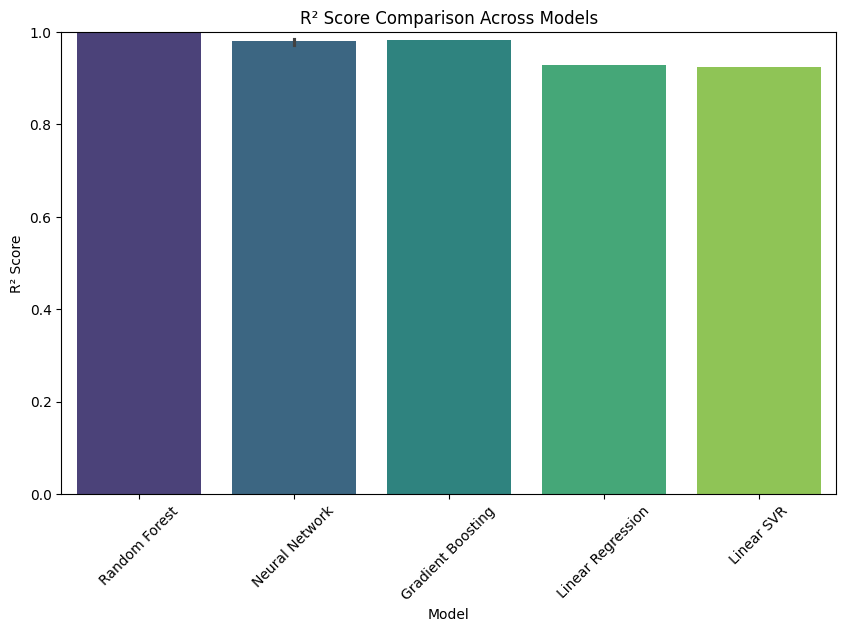

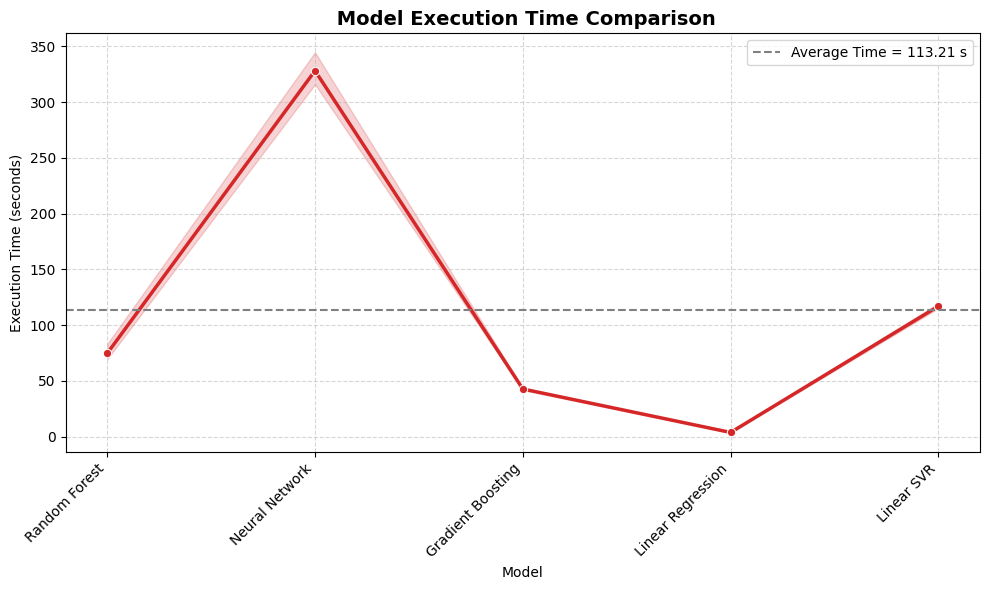

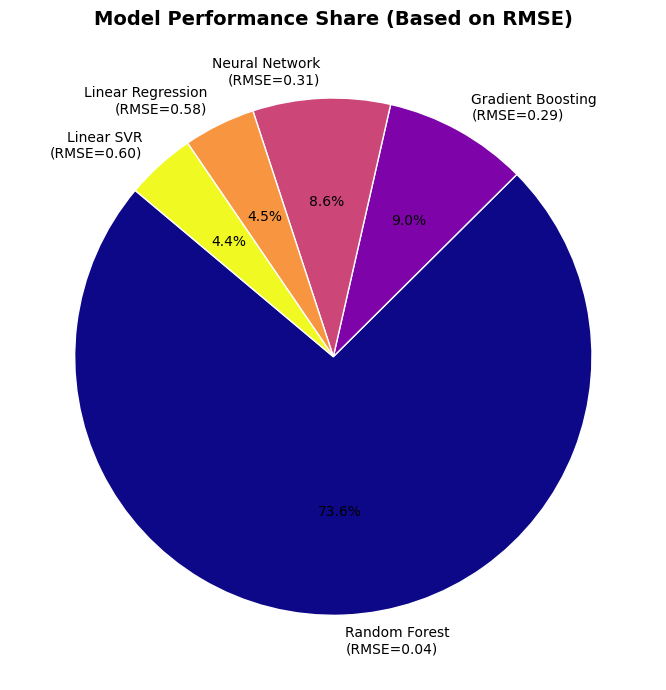

In [58]:

# Load results dataset
data_results = pd.read_csv('/content/Model_Performance_Summary.csv')
plt.figure(figsize=(10,6))
# Sort models by R² for cleaner visualization
data_results = data_results.sort_values(by='R2', ascending=False)

sns.barplot(x='Model', y='R2', data=data_results, palette='viridis')
plt.title("R² Score Comparison Across Models")
plt.ylabel("R² Score")
plt.ylim(0, 1)
plt.xticks(rotation=45)
plt.show()

# Sort models by execution time (optional for clarity)
data_time = data_results.sort_values(by='Train_Time_sec', ascending=True)

# Create the line chart
plt.figure(figsize=(10,6))
sns.lineplot(
    x='Model',
    y='Train_Time_sec',
    data=data_results,
    marker='o',
    linewidth=2.5,
    color='tab:red'
)

# Highlight the average execution time
avg_time = data_time['Train_Time_sec'].mean()
plt.axhline(avg_time, color='gray', linestyle='--', linewidth=1.5,
            label=f'Average Time = {avg_time:.2f} s')

# Customize the chart
plt.title(" Model Execution Time Comparison", fontsize=14, weight='bold')
plt.ylabel("Execution Time (seconds)")
plt.xlabel("Model")
plt.xticks(rotation=45, ha='right')
plt.legend()
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

# Pie chart of the RMSE
# Aggregate to ensure one entry per model
# (take the average RMSE per model if duplicates exist)
data_rmse = data_results.groupby('Model', as_index=False)['RMSE'].mean()

# Optional: sort models by RMSE (best first)
data_rmse = data_rmse.sort_values(by='RMSE', ascending=True)

# Compute performance share (inverted RMSE so lower RMSE = larger slice)
data_rmse['Performance_Share'] = 1 / data_rmse['RMSE']
data_rmse['Performance_Share'] = data_rmse['Performance_Share'] / data_rmse['Performance_Share'].sum()

# Plot pie chart
plt.figure(figsize=(7,7))
plt.pie(
    data_rmse['Performance_Share'],
    labels=[f"{m}\n(RMSE={r:.2f})" for m, r in zip(data_rmse['Model'], data_rmse['RMSE'])],
    autopct='%1.1f%%',
    startangle=140,
    colors=plt.cm.plasma(np.linspace(0, 1, len(data_rmse))),
    wedgeprops={'edgecolor': 'white'}
)

plt.title("Model Performance Share (Based on RMSE)", fontsize=14, weight='bold')
plt.tight_layout()
plt.show()

# **Checking for potential Data Leakage**

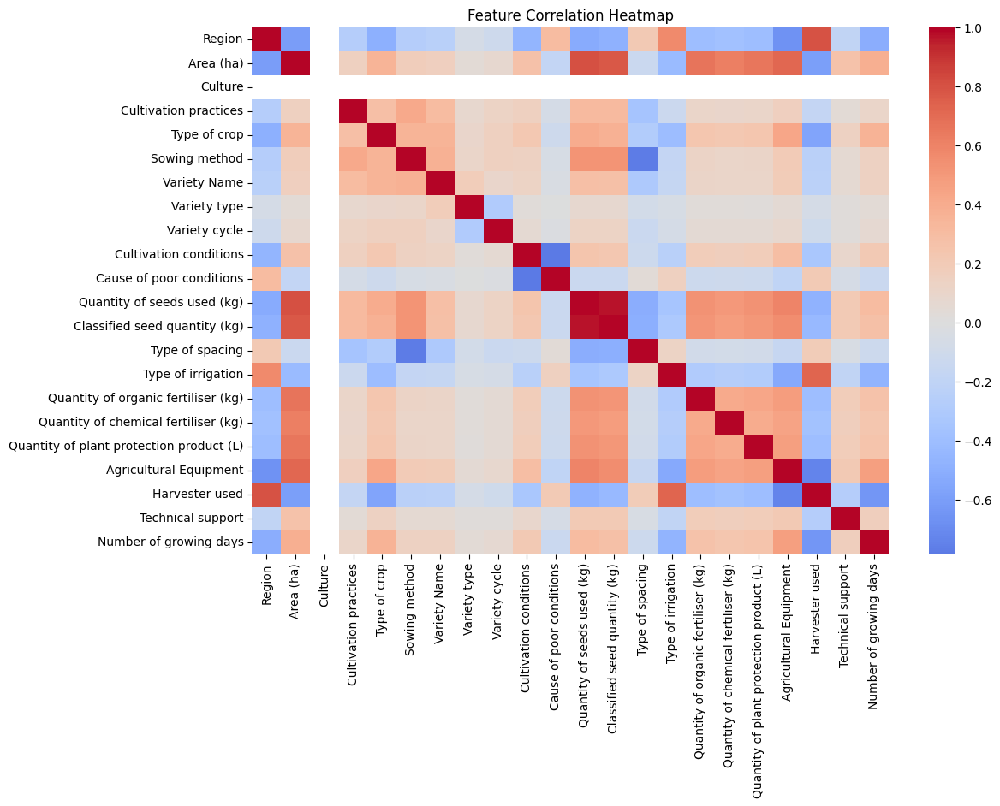


Top correlations with target (possible data leakage if extremely high>0.95):
target                                      1.000000
Area (ha)                                   0.945918
Quantity of seeds used (kg)                 0.763226
Classified seed quantity (kg)               0.742984
Quantity of organic fertiliser (kg)         0.629275
Quantity of plant protection product (L)    0.620399
Agricultural Equipment                      0.598042
Quantity of chemical fertiliser (kg)        0.589170
Number of growing days                      0.268138
Technical support                           0.256349
Name: target, dtype: float64


In [59]:
import seaborn as sns
import matplotlib.pyplot as plt

# Compute feature-feature correlations
feature_corr = X_train.corr()

# Plot heatmap of feature correlations
plt.figure(figsize=(12, 8))
sns.heatmap(feature_corr, cmap="coolwarm", center=0, annot=False)
plt.title("Feature Correlation Heatmap")
plt.show()

# Compute feature-target correlations
target_corr = X_train.copy()
target_corr['target'] = y_train
corr_with_target = target_corr.corr()['target'].sort_values(ascending=False)

print("\nTop correlations with target (possible data leakage if extremely high>0.95):")
print(corr_with_target.head(10))


# **Conclucion**
- The correlation analysis shows no features exceeding the 0.95 leakage threshold. However, Area (ha) is very close to this threshold, indicating that the target is strongly scale-dependent.
- Other moderately high correlations (0.58–0.76) are consistent with agricultural input use being proportional to farm area. These do not constitute direct leakage but highlight that the model may rely heavily on size-related variables.

Therefore, we verified that none of the features are derived from the target variable or represent future information. Based on this review, no direct data leakage is detected.

In [60]:
# Ensure consistent column names
df.columns = df.columns.str.strip()

# Select only numerical columns
num_cols = df.select_dtypes(include=['float64', 'int64']).columns

# Compute correlation matrix
corr = df[num_cols].corr()

# Correlation with Yield
target_corr = corr["Yield (T/Ha)"].sort_values(ascending=False)
print(target_corr)

Weight of rice without moisture (g/m2) /1000    1.000000
Yield (T/Ha)                                    1.000000
Dry weight (g/m2) /1000                         0.999266
Area (ha)                                       0.946046
Quantity of seeds used (kg)                     0.763840
Classified seed quantity (kg)                   0.743831
Quantity of organic fertiliser (kg)             0.630334
Quantity of plant protection product (L)        0.620502
Agricultural Equipment                          0.597501
Quantity of chemical fertiliser (kg)            0.590011
Number of growing days                          0.267659
Technical support                               0.253809
Type of crop                                    0.253726
Cultivation conditions                          0.216504
Sowing method                                   0.133251
Cultivation practices                           0.125666
Variety Name                                    0.120440
Variety cycle                  

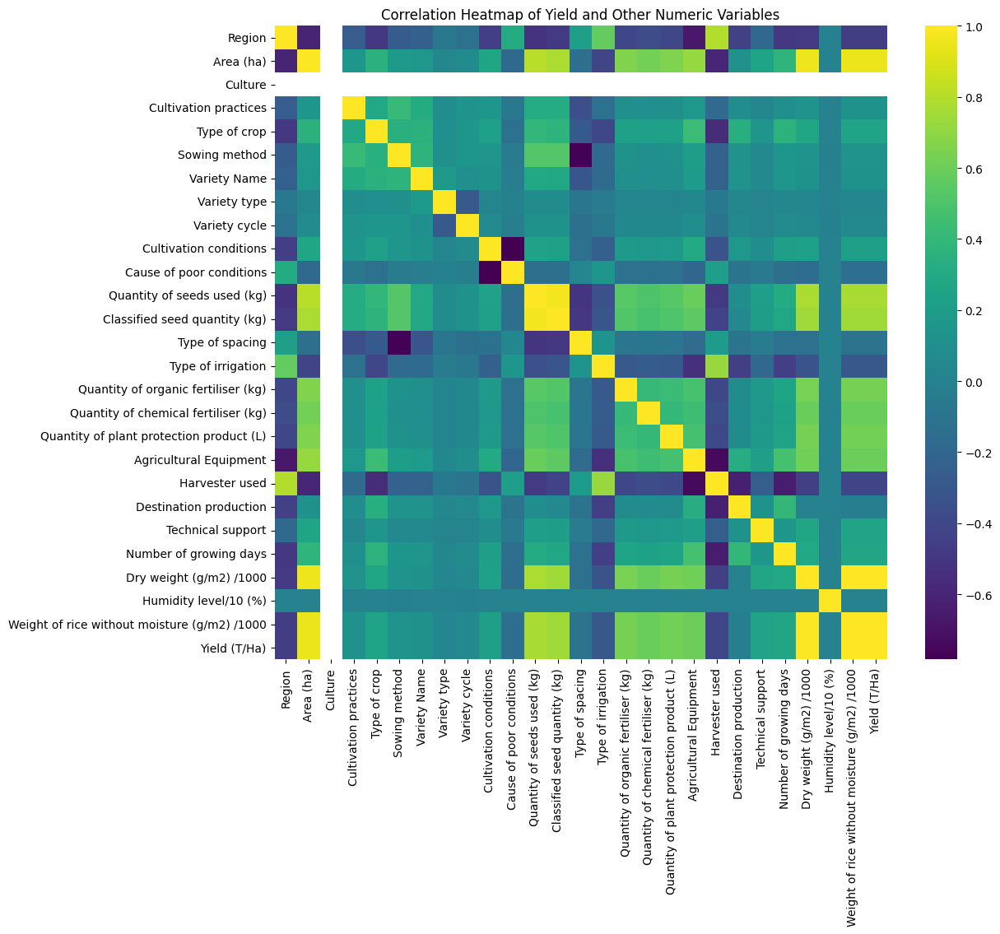

In [61]:
# Select only numeric columns
numeric_df = df.select_dtypes(include='number')

# Correlation heatmap
plt.figure(figsize=(12,10))
sns.heatmap(numeric_df.corr(), cmap='viridis', annot=False)
plt.title("Correlation Heatmap of Yield and Other Numeric Variables")
plt.show()

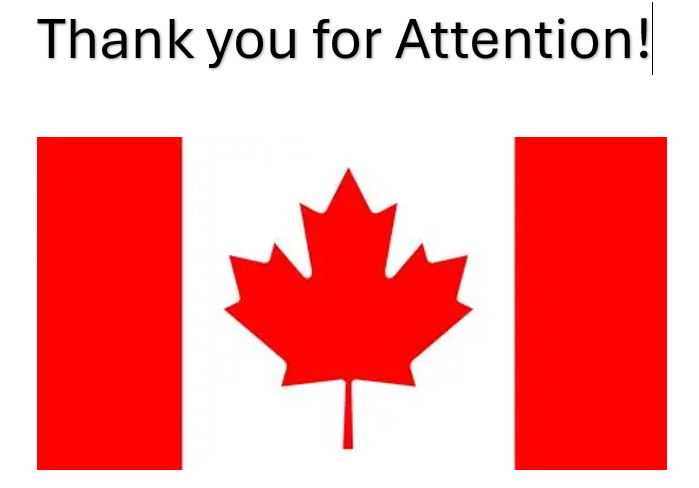